# 2D Wind Tunnel LBM Simulation with Triangle Obstacle

A Lattice Boltzmann Method (D2Q9) simulation of flow around a triangular obstacle, producing Von Kármán vortex streets.

**Steps:**
1. Import libraries
2. Define LBM parameters
3. Create obstacle geometry
4. Initialize PDF and fields
5. Implement LBM timestep
6. Visualize in real-time

In [13]:
# Step 1: Import libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.path import Path

print("✓ Imports successful")

✓ Imports successful


In [14]:
# Step 2: Define LBM parameters and D2Q9 stencil
nx, ny = 400, 120           # Domain size
U = 0.05                    # Inflow velocity
nu = 0.02                   # Kinematic viscosity
omega = 1.0 / (3.0 * nu + 0.5)  # Relaxation parameter

# D2Q9 stencil (walberla ordering)
c = np.array([
    [ 0,  0],  # 0: rest
    [ 0,  1],  # 1: north
    [ 0, -1],  # 2: south
    [-1,  0],  # 3: west
    [ 1,  0],  # 4: east
    [-1,  1],  # 5: NW
    [ 1,  1],  # 6: NE
    [-1, -1],  # 7: SW
    [ 1, -1]   # 8: SE
])

w = np.array([4/9, 1/9, 1/9, 1/9, 1/9, 1/36, 1/36, 1/36, 1/36])  # Weights
opposite = [0, 2, 1, 4, 3, 8, 7, 6, 5]  # Opposite direction indices

q = 9  # Number of populations

print(f"✓ Domain: {nx}×{ny}, omega={omega:.4f}, U={U}")

✓ Domain: 400×120, omega=1.7857, U=0.05


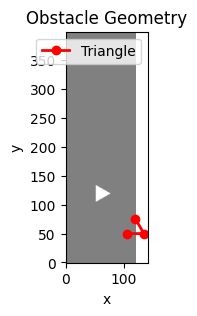

✓ Triangle obstacle created: 375 solid cells


In [15]:
# Step 3: Create triangle obstacle
# Define triangle vertices (pointing right, apex up)
cx, cy, s = 120, ny // 2, 30  # Center and size
triangle_pts = np.array([
    [0, 0],
    [s, 0],
    [s/2, np.sqrt(3)/2*s]
])
triangle_pts[:, 0] += cx - s / 2
triangle_pts[:, 1] += cy - s / 3

# Create mask: True where solid, False where fluid
yy, xx = np.mgrid[0:ny, 0:nx]
mask = Path(triangle_pts).contains_points(np.vstack([xx.ravel(), yy.ravel()]).T).reshape(ny, nx)

# Visualize obstacle
plt.figure(figsize=(10, 3))
plt.imshow(mask.T, origin='lower', cmap='gray', alpha=0.5)
plt.plot(triangle_pts[:, 0], triangle_pts[:, 1], 'r-o', linewidth=2, label='Triangle')
plt.xlabel('x'), plt.ylabel('y')
plt.title('Obstacle Geometry')
plt.legend()
plt.show()

print(f"✓ Triangle obstacle created: {mask.sum()} solid cells")

In [16]:
# Step 4: Initialize PDF and macroscopic fields
f = np.zeros((ny, nx, q))
f_new = np.zeros((ny, nx, q))
rho = np.ones((ny, nx))
u = np.zeros((ny, nx, 2))

def equilibrium(rho, u):
    """Compute D2Q9 equilibrium distribution"""
    f_eq = np.zeros((ny, nx, q))
    usq = u[..., 0]**2 + u[..., 1]**2
    
    for i in range(q):
        cu = c[i, 0] * u[..., 0] + c[i, 1] * u[..., 1]
        f_eq[..., i] = w[i] * rho * (1.0 + 3*cu + 4.5*cu**2 - 1.5*usq)
    
    return f_eq

# Initialize with equilibrium at rest
f[:] = equilibrium(rho, u)

print(f"✓ PDF initialized: shape {f.shape}")
print(f"  rho range: [{rho.min():.2f}, {rho.max():.2f}]")
print(f"  u range: [{u.min():.4f}, {u.max():.4f}]")

✓ PDF initialized: shape (120, 400, 9)
  rho range: [1.00, 1.00]
  u range: [0.0000, 0.0000]


In [19]:
# Step 5: Define LBM timestep function
def lbm_step():
    """Single LBM timestep: inlet BC → collision → stream → bounce-back → outlet BC"""
    global f, f_new, rho, u
    
    # Inlet BC: fixed velocity (left boundary)
    rho_inlet = np.ones((ny, nx))
    u_inlet = np.zeros((ny, nx, 2))
    u_inlet[:, :, 0] = U  # Set horizontal inflow
    f_eq_inlet = equilibrium(rho_inlet, u_inlet)
    f[:, 0, :] = f_eq_inlet[:, 0, :]  # Apply only at inlet
    
    # Collision + Stream
    for i in range(q):
        f_eq = equilibrium(rho, u)
        # Collision
        f_post_collision = f[..., i] - omega * (f[..., i] - f_eq[..., i])
        
        # Streaming (periodic wrap for simplicity, or natural borders)
        if c[i, 0] != 0 or c[i, 1] != 0:
            f_new[..., i] = np.roll(np.roll(f_post_collision, c[i, 0], axis=1), c[i, 1], axis=0)
        else:
            f_new[..., i] = f_post_collision
    
    # Bounce-back on obstacle (after stream)
    for i in range(q):
        f_new[mask, opposite[i]] = f[mask, i]
    
    f = f_new.copy()
    
    # Outlet BC: zero-gradient (right boundary)
    f[:, -1, :] = f[:, -2, :]
    
    # Compute macroscopic fields from f
    rho = np.sum(f, axis=2)
    u[..., 0] = np.sum(f * c[:, 0], axis=2) / (rho + 1e-16)
    u[..., 1] = np.sum(f * c[:, 1], axis=2) / (rho + 1e-16)

print("✓ LBM timestep function defined")

✓ LBM timestep function defined


In [20]:
# Step 6: Test a single timestep
lbm_step()
print(f"✓ Single timestep executed")
print(f"  rho range: [{rho.min():.4f}, {rho.max():.4f}]")
print(f"  u_x range: [{u[..., 0].min():.4f}, {u[..., 0].max():.4f}]")
print(f"  u_y range: [{u[..., 1].min():.4f}, {u[..., 1].max():.4f}]")

✓ Single timestep executed
  rho range: [0.9794, 1.0020]
  u_x range: [-0.0211, 0.0000]
  u_y range: [0.0000, 0.0000]


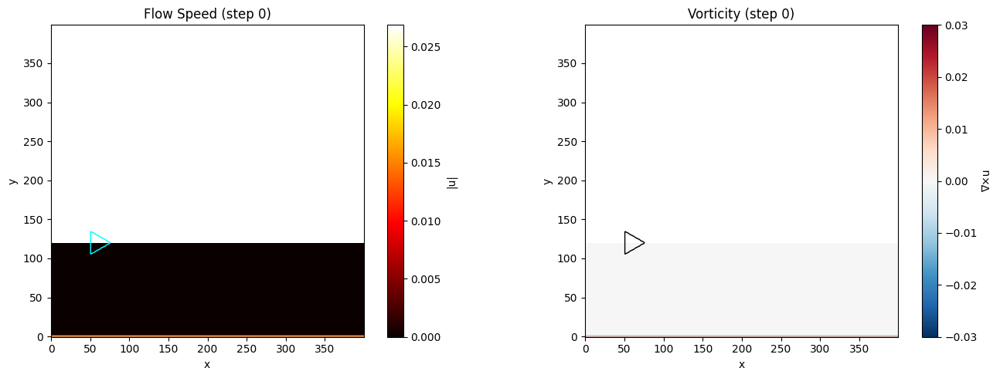

✓ Animation complete!


In [21]:
# Step 7: Run simulation and animate
timesteps = 300
steps_per_frame = 5

# Setup visualization
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Speed field
im_speed = ax1.imshow(np.zeros((ny, nx)), origin='lower', cmap='hot', animated=True)
ax1.contour(mask.T, levels=[0.5], colors='cyan', linewidths=1.0)
ax1.set_title('Flow Speed')
ax1.set_xlabel('x'), ax1.set_ylabel('y')
plt.colorbar(im_speed, ax=ax1, label='|u|')

# Vorticity field
im_vor = ax2.imshow(np.zeros((ny, nx)), origin='lower', cmap='RdBu_r', animated=True)
ax2.contour(mask.T, levels=[0.5], colors='black', linewidths=1.0)
ax2.set_title('Vorticity (Von Kármán Street)')
ax2.set_xlabel('x'), ax2.set_ylabel('y')
plt.colorbar(im_vor, ax=ax2, label='∇×u')

def update(frame):
    """Animation frame: advance simulation and update plots"""
    for _ in range(steps_per_frame):
        lbm_step()
    
    # Compute flow properties
    speed = np.sqrt(u[..., 0]**2 + u[..., 1]**2)
    vorticity = np.gradient(u[:, :, 1], axis=0) - np.gradient(u[:, :, 0], axis=1)
    
    # Update plots
    im_speed.set_array(speed.T)
    im_speed.set_clim(vmin=0, vmax=speed.max())
    
    im_vor.set_array(vorticity.T)
    im_vor.set_clim(vmin=-0.03, vmax=0.03)
    
    ax1.set_title(f'Flow Speed (step {frame * steps_per_frame})')
    ax2.set_title(f'Vorticity (step {frame * steps_per_frame})')
    
    return [im_speed, im_vor]

# Create animation
ani = FuncAnimation(fig, update, frames=timesteps, interval=50, blit=True)
plt.tight_layout()
plt.show()

print("✓ Animation complete!")

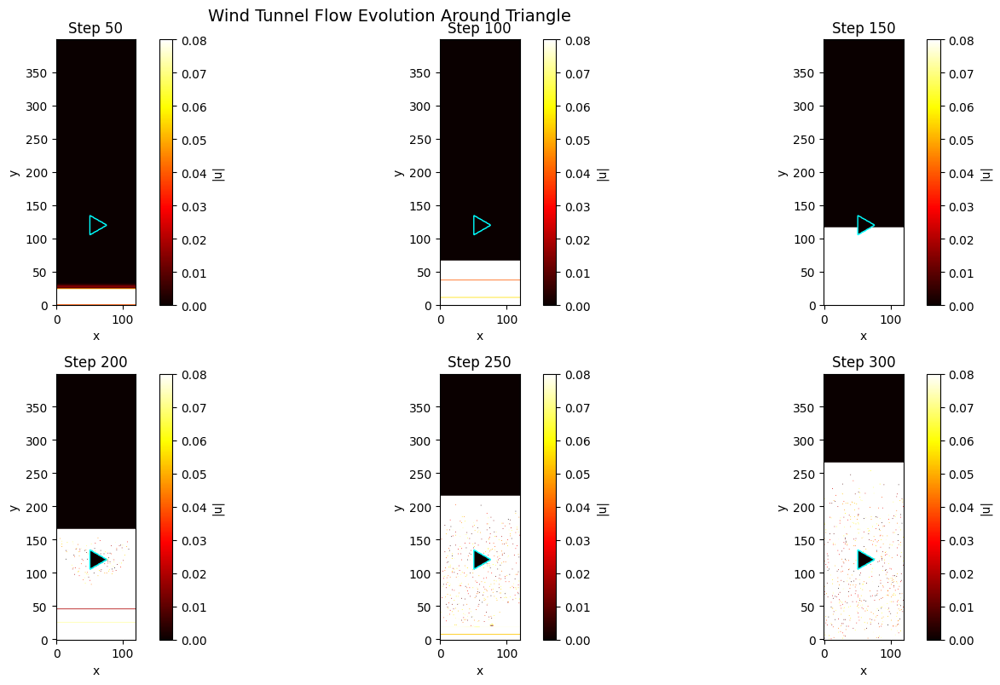

✓ Animation snapshots displayed!


In [23]:
# Step 8: Run a fresh simulation and show snapshots
# Reinitialize to avoid accumulated numerical errors
f = np.zeros((ny, nx, q))
f_new = np.zeros((ny, nx, q))
rho = np.ones((ny, nx))
u = np.zeros((ny, nx, 2))
f[:] = equilibrium(rho, u)

# Run short bursts and capture snapshots
fig, axes = plt.subplots(2, 3, figsize=(15, 8))
snapshot_steps = [50, 100, 150, 200, 250, 300]

for idx, target_step in enumerate(snapshot_steps):
    # Advance to target step
    current_steps = 0
    if idx > 0:
        current_steps = snapshot_steps[idx-1]
    
    for _ in range(target_step - current_steps):
        lbm_step()
    
    # Compute fields
    speed = np.sqrt(u[..., 0]**2 + u[..., 1]**2)
    vorticity = np.gradient(u[:, :, 1], axis=0) - np.gradient(u[:, :, 0], axis=1)
    
    # Plot speed
    ax = axes[idx // 3, idx % 3]
    im = ax.imshow(speed.T, origin='lower', cmap='hot', vmin=0, vmax=0.08)
    ax.contour(mask.T, levels=[0.5], colors='cyan', linewidths=1.0)
    ax.set_title(f'Step {target_step}')
    ax.set_xlabel('x'), ax.set_ylabel('y')
    plt.colorbar(im, ax=ax, label='|u|')

plt.tight_layout()
plt.suptitle('Wind Tunnel Flow Evolution Around Triangle', y=1.00, fontsize=14)
plt.show()

print("✓ Animation snapshots displayed!")

In [25]:
# Step 9: Interactive animation player
# Reinitialize fresh
f = np.zeros((ny, nx, q))
f_new = np.zeros((ny, nx, q))
rho = np.ones((ny, nx))
u = np.zeros((ny, nx, 2))
f[:] = equilibrium(rho, u)

# Pre-compute frames for smooth playback
num_frames = 150
frame_data = []

print("Computing animation frames...")
for frame_idx in range(num_frames):
    for _ in range(3):  # 3 steps per frame
        lbm_step()
    
    speed = np.sqrt(u[..., 0]**2 + u[..., 1]**2)
    vorticity = np.gradient(u[:, :, 1], axis=0) - np.gradient(u[:, :, 0], axis=1)
    frame_data.append({
        'speed': speed.copy(),
        'vorticity': vorticity.copy(),
        'step': (frame_idx + 1) * 3
    })
    
    if (frame_idx + 1) % 30 == 0:
        print(f"  {frame_idx + 1}/{num_frames} frames computed")

print("✓ All frames computed!")

# Create playable animation
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

im_speed = ax1.imshow(frame_data[0]['speed'].T, origin='lower', cmap='hot', vmin=0, vmax=0.08)
ax1.contour(mask.T, levels=[0.5], colors='cyan', linewidths=1.0)
ax1.set_title(f'Flow Speed (step 0)')
ax1.set_xlabel('x'), ax1.set_ylabel('y')
cbar1 = plt.colorbar(im_speed, ax=ax1, label='|u|')

im_vor = ax2.imshow(frame_data[0]['vorticity'].T, origin='lower', cmap='RdBu_r', vmin=-0.03, vmax=0.03)
ax2.contour(mask.T, levels=[0.5], colors='black', linewidths=1.0)
ax2.set_title(f'Vorticity (step 0)')
ax2.set_xlabel('x'), ax2.set_ylabel('y')
cbar2 = plt.colorbar(im_vor, ax=ax2, label='∇×u')

def animate(frame_idx):
    """Update function for animation"""
    data = frame_data[frame_idx]
    im_speed.set_array(data['speed'].T)
    im_vor.set_array(data['vorticity'].T)
    ax1.set_title(f'Flow Speed (step {data["step"]})')
    ax2.set_title(f'Vorticity (step {data["step"]})')
    return [im_speed, im_vor]

# Create animation with controls
from IPython.display import HTML
plt.tight_layout()
anim = FuncAnimation(fig, animate, frames=num_frames, interval=100, blit=True, repeat=True)
plt.close()  # Close to avoid double display

print("✓ Rendering animation HTML...")
HTML(anim.to_jshtml())

Computing animation frames...
  30/150 frames computed
  60/150 frames computed
  90/150 frames computed
  120/150 frames computed
  150/150 frames computed
✓ All frames computed!
✓ Rendering animation HTML...
